## Clustering

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
import os
import re

In [21]:
df = pd.read_csv('yelp_reviews_mtl.csv')
df

,user_url,user_name,user_city,user_rating,user_review,biz_id
0,/user_details?userid=lxGwbMkC_I9D7GhGT23mFQ,Cynthia L.,"Ville-Marie, Montreal, Canada",5,Went here pre-covid with my bf and best friend...,0W4lkclzZThpx3V65bVgig
1,/user_details?userid=IMHvG_ysz6akYIM-GO18kg,Andrea D.,"Le Plateau-Mont-Royal, Montreal, Canada",5,*home delivery review* Amazing. Literally tast...,0W4lkclzZThpx3V65bVgig
2,/user_details?userid=DlNz5SxdBYRaZ_pnyIxn6g,Rhonda B.,"Montreal, Canada",5,I must add a disclaimer to this review since I...,0W4lkclzZThpx3V65bVgig
3,/user_details?userid=gAvuqk1q2uAo2BJzZDLmDQ,Matt M.,"Oklahoma City, OK",5,One of my favorite Quebecois institutions!No t...,0W4lkclzZThpx3V65bVgig
4,/user_details?userid=3VLcNOmumPkwuSoQxTBHTw,Marc I.,"Ajax, Canada",5,Is there anything better that a true Smoked me...,0W4lkclzZThpx3V65bVgig
...,...,...,...,...,...,...
64862,/user_details?userid=XEsPq0Kd7Uxq4Guv0Dj6Wg,Nicole R.,"Montreal, Canada",2,Such a disappointing experience!! Went to Raso...,pJrM4yAZo0Gs63D9UCyCSQ
64863,/user_details?userid=S_sIeCOqy7F4RFs0le1cDQ,Joel S.,"Los Angeles, CA",5,"Delicious food, tasty cocktails, reasonably pr...",pJrM4yAZo0Gs63D9UCyCSQ
64864,/user_details?userid=tEZsTQEkZSK0RMjYZoZzZA,Hani A.,"Le Sud-Ouest, Canada",3,"rating for new terrace, too much noise coming ...",pJrM4yAZo0Gs63D9UCyCSQ
64865,/user_details?userid=z5xzL1Zl5iiHLuOqn07CLg,E T.,"Ottawa, Canada",5,Staff were friendly and helpful. The food was ...,pJrM4yAZo0Gs63D9UCyCSQ


In [22]:
# Preprocessing
from sklearn.feature_extraction.text import TfidfVectorizer
# remove frequent words (max_df=0.95) and very rare words (min_df=2)
tfidf = TfidfVectorizer(max_df=0.95, min_df=2, stop_words='english')
dtm = tfidf.fit_transform(df['user_review'])

In [23]:
# NMF
from sklearn.decomposition import NMF
# n_components is the arbitrary number of expected topics
nmf_model = NMF(n_components=5,random_state=42)
nmf_model.fit(dtm)

NMF(n_components=5, random_state=42)

In [24]:
# Get top words by components (topics)
for index,topic in enumerate(nmf_model.components_):
    print(f'THE TOP 15 WORDS FOR TOPIC #{index}')
    print([tfidf.get_feature_names()[i] for i in topic.argsort()[-15:]])
    print('\n')

THE TOP 15 WORDS FOR TOPIC #0
['did', 'didn', 'montreal', 'order', 'dish', 'meal', 'table', 'got', 'like', 'came', 'ordered', 'menu', 'time', 'just', 'restaurant']


THE TOP 15 WORDS FOR TOPIC #1
['just', 'fries', 'best', 'bread', 'wait', 'mustard', 'pickle', 'deli', 'sandwiches', 'montreal', 'line', 'schwartz', 'sandwich', 'smoked', 'meat']


THE TOP 15 WORDS FOR TOPIC #2
['nice', 'best', 'definitely', 'montreal', 'recommend', 'excellent', 'delicious', 'atmosphere', 'staff', 'friendly', 'amazing', 'place', 'service', 'food', 'great']


THE TOP 15 WORDS FOR TOPIC #3
['line', 'regular', 'classic', 'try', 'place', 'best', 'burger', 'montreal', 'banquise', 'la', 'curds', 'cheese', 'fries', 'gravy', 'poutine']


THE TOP 15 WORDS FOR TOPIC #4
['sauce', 'like', 'dumplings', 'noodles', 'pork', 'soup', 'fried', 'spicy', 'pretty', 'food', 'nice', 'place', 'really', 'chicken', 'good']




In [25]:
def plot_top_words(model, feature_names, n_top_words, title):
    fig, axes = plt.subplots(1, 5, figsize=(20, 5), sharex=True)
    axes = axes.flatten()
    for topic_idx, topic in enumerate(model.components_):
        top_features_ind = topic.argsort()[:-n_top_words - 1:-1]
        top_features = [feature_names[i] for i in top_features_ind]
        weights = topic[top_features_ind]

        ax = axes[topic_idx]
        ax.barh(top_features, weights, height=0.7)
        ax.set_title(f'Topic {topic_idx +1}',
                     fontdict={'fontsize': 20})
        ax.invert_yaxis()
        ax.tick_params(axis='both', which='major', labelsize=15)
        for i in 'top right left'.split():
            ax.spines[i].set_visible(False)
        fig.suptitle(title, fontsize=25)

    plt.subplots_adjust(top=0.90, bottom=0.05, wspace=0.90, hspace=0.3)
    plt.show()

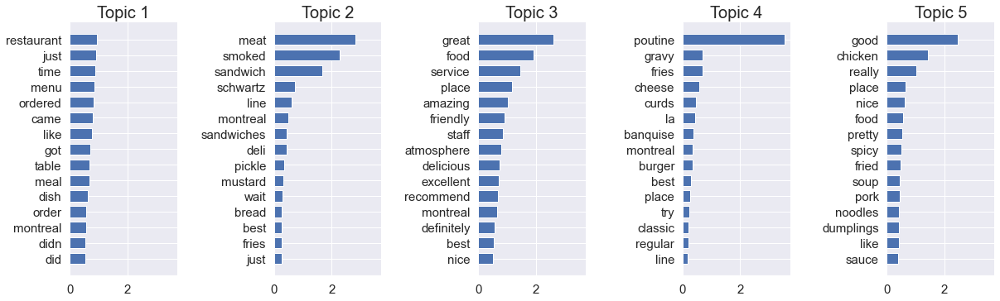

In [26]:
tfidf_feature_names = tfidf.get_feature_names()
plot_top_words(nmf_model, tfidf_feature_names, 15, "")

In [27]:
# Reasign topics to the dataset
topic_results = nmf_model.transform(dtm)
topics = pd.Series(topic_results.argmax(axis=1))
my_topic = {0:'words',1:'service',2:'categories',3:'popular',4:'price'}
labels = topics.map(my_topic)

In [28]:
#from sklearn.decomposition import PCA
#pca = PCA(200)
#projected = pca.fit_transform(dtm)

import umap
model = umap.UMAP(n_components=2)
proj = model.fit_transform(dtm)

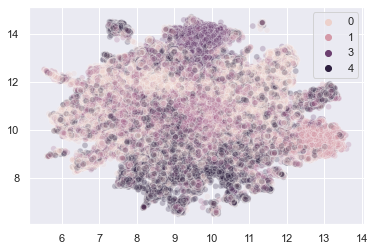

In [29]:
#plt.scatter(x=proj[:, 0], y=proj[:, 1], alpha=0.05, hue=topics);
sns.scatterplot(x=proj[:, 0], y=proj[:, 1], alpha=0.25, hue=topics, cmap='husl');

In [30]:
# 3D
import umap
model_3d = umap.UMAP(n_components=3)
proj_3d = model_3d.fit_transform(dtm)

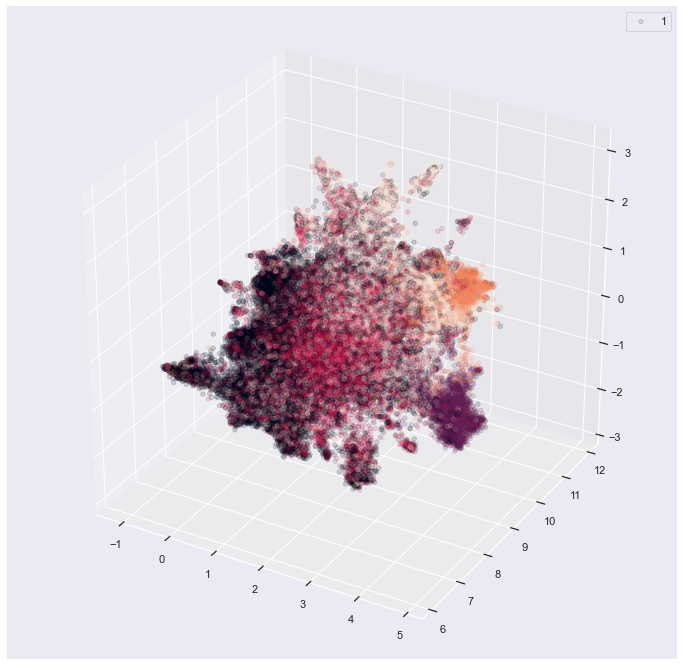

In [31]:
from mpl_toolkits.mplot3d import Axes3D

sns.set(style = "darkgrid")

fig = plt.figure(figsize=(12,12))
ax = fig.add_subplot(111, projection = '3d')
x = proj_3d[:, 0]
y = proj_3d[:, 1]
z = proj_3d[:, 2]

#ax.set_xlabel("x")
#ax.set_ylabel("y")
#ax.set_zlabel("z")
ax.scatter(x, y, z, c=topics, alpha=0.15)
#ax.legend(labels=['words','service','categories','popular','price'])
ax.legend(labels=topics)

plt.show()

In [32]:
df2 = pd.read_csv('places_reviews_mtl.csv')
reviews = df2.text.dropna()
df2.sample(5)

,Unnamed: 0,place_id,name,text,author_name,author_url,language,rating,relative_time_description,time,profile_photo_url
1803,1814,ChIJZ50-Fdo7yUwRJ8K3hxw2Erk,Bistro Grace,A gem in the West Island! I am a regular and e...,Alessandra B,https://www.google.com/maps/contrib/1067939396...,en,5,a year ago,1569763850,https://lh3.googleusercontent.com/-zK8A-JvBKz4...
6900,6951,ChIJW47qfa0byUwR1v--PAxCapo,Restaurant café Saigon,Showed up close to closing on a Saturday nigh...,Pedro Paparazzi,https://www.google.com/maps/contrib/1039959827...,en,5,6 months ago,1599362697,https://lh3.googleusercontent.com/a-/AOh14GhKm...
7381,7438,ChIJzQxlVkElyUwRf3wrTTYXSqc,ACHOURA DELI,Can't wait to go back I'm craving for this ...,CODIN ILIEV,https://www.google.com/maps/contrib/1132798053...,en,5,a week ago,1613956035,https://lh5.googleusercontent.com/-MayOHF4XA_Y...
8954,9023,ChIJAAAAAAAAAAAR5jxYifn__zo,Pizza Pizza,Always hot and fresh! pick up gets ready very ...,Zainab Munawar,https://www.google.com/maps/contrib/1125917874...,en,5,9 months ago,1590546246,https://lh4.googleusercontent.com/-bhTXM7w6QIc...
5243,5280,ChIJU1y5EqsbyUwR7Sa24yC9vl8,Resto Pop Panini,"Defenetly not a 4.9 stars, panini are very basic!",Alexis Adrian,https://www.google.com/maps/contrib/1018507708...,en,3,a year ago,1580756113,https://lh3.googleusercontent.com/a-/AOh14Ggml...


In [7]:
# Preprocessing
from sklearn.feature_extraction.text import TfidfVectorizer
# remove frequent words (max_df=0.95) and very rare words (min_df=2)
tfidf = TfidfVectorizer(max_df=0.95, min_df=2, stop_words='english')
dtm = tfidf.fit_transform(reviews)

In [8]:
# NMF
from sklearn.decomposition import NMF
# n_components is the arbitrary number of expected topics
nmf_model = NMF(n_components=5,random_state=42)
nmf_model.fit(dtm)

C:\Users\user\anaconda3\lib\site-packages\sklearn\decomposition\_nmf.py:1076: ConvergenceWarning: Maximum number of iterations 200 reached. Increase it to improve convergence.
  warnings.warn("Maximum number of iterations %d reached. Increase it to"


NMF(n_components=5, random_state=42)

In [9]:
# Get top words by components (topics)
for index,topic in enumerate(nmf_model.components_):
    print(f'THE TOP 15 WORDS FOR TOPIC #{index}')
    print([tfidf.get_feature_names()[i] for i in topic.argsort()[-15:]])
    print('\n')

THE TOP 15 WORDS FOR TOPIC #0
['atmosphere', 'drinks', 'breakfast', 'staff', 'people', 'experience', 'customer', 'quality', 'ambiance', 'price', 'fast', 'prices', 'food', 'service', 'great']


THE TOP 15 WORDS FOR TOPIC #1
['taste', 'bit', 'clean', 'reasonable', 'expensive', 'pretty', 'portions', 'fast', 'quality', 'prices', 'really', 'price', 'service', 'food', 'good']


THE TOP 15 WORDS FOR TOPIC #2
['absolutely', 'restaurant', 'try', 'thank', 'customer', 'fast', 'fresh', 'definitely', 'highly', 'recommend', 'excellent', 'delicious', 'amazing', 'food', 'service']


THE TOP 15 WORDS FOR TOPIC #3
['restaurant', 'fresh', 'poutine', 'like', 'montreal', 'town', 'just', 'sushi', 've', 'ordered', 'time', 'chicken', 'order', 'pizza', 'best']


THE TOP 15 WORDS FOR TOPIC #4
['tasty', 'visit', 'really', 'spot', 'highly', 'food', 'clean', 'recommend', 'super', 'love', 'restaurant', 'friendly', 'staff', 'nice', 'place']




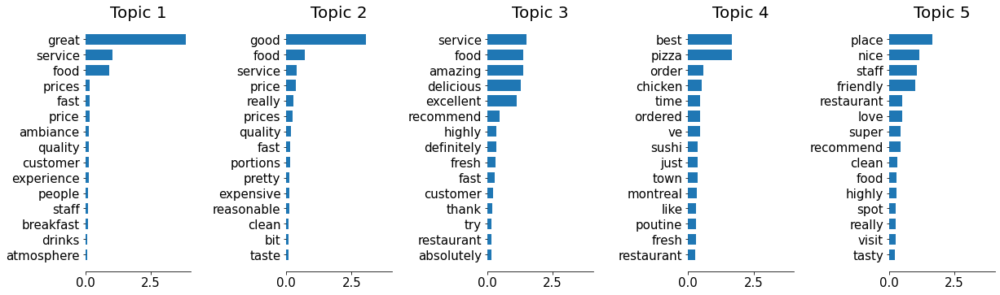

In [11]:
tfidf_feature_names = tfidf.get_feature_names()
plot_top_words(nmf_model, tfidf_feature_names, 15, "")

In [19]:
# keywords by topics
food = 'food|taste|tasty|delicious|fresh|cold|hot|disgusting|dry'
service = 'staff|service|friendly|fast|quick|slow|wait|polite|rude'
value = 'price|value|portion|size|expensive|overpriced|affordable|reasonable'
experience = 'ambiance|atmosphere|experience|noise|noisy|mood|crowd'
clean = 'clean|dirty|filthy|gross|bathroom'

# subset reviews containing keywords
food = df2[df2['text'].str.contains(food, na=False)]
serv = df2[df2['text'].str.contains(service, na=False)]
val = df2[df2['text'].str.contains(value, na=False)]
exp = df2[df2['text'].str.contains(experience, na=False)]
clean = df2[df2['text'].str.contains(clean, na=False)]

# number of reviews with the corresponding feature
print(len(food))
print(len(serv))
print(len(val))
print(len(exp))
print(len(clean))

5896
4802
2177
1074
386
